# Multi Modal Search with LanceDB

In [3]:
%pip install lancedb open_clip_torch

  Obtaining dependency information for open_clip_torch from https://files.pythonhosted.org/packages/9c/b7/aca0649087854dde2f490696359a918274cb5b9c04e624b22849c66e9f09/open_clip_torch-2.26.1-py3-none-any.whl.metadata
  Obtaining dependency information for torchvision from https://files.pythonhosted.org/packages/d4/90/cab820b96d4d1a36b088774209d2379cf49eda8210c8fee13552383860b7/torchvision-0.19.1-cp310-cp310-macosx_11_0_arm64.whl.metadata
  Obtaining dependency information for ftfy from https://files.pythonhosted.org/packages/ed/46/14d230ad057048aea7ccd2f96a80905830866d281ea90a6662a825490659/ftfy-6.2.3-py3-none-any.whl.metadata
  Obtaining dependency information for timm from https://files.pythonhosted.org/packages/e7/0e/ef97f6d8c399bf5842af0dd5a4f5ac55b2f169d62e29ecbf7663e1cb1438/timm-1.0.9-py3-none-any.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.4/42.4 kB 2.3 MB/s eta 0:00:00
  Obtaining dependency information for torch>=1.9.0 from https://files.pythonhosted.org/packa

In [4]:
import lancedb
from lancedb.embeddings import EmbeddingFunctionRegistry
from lancedb.pydantic import LanceModel, Vector
from PIL import Image

/Users/markhneedham/miniforge3/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [5]:
registry = EmbeddingFunctionRegistry.get_instance()
clip = registry.get("open-clip").create()

/Users/markhneedham/miniforge3/lib/python3.10/site-packages/open_clip/factory.py:129: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path, 

In [7]:
class ImageFile(LanceModel):
  vector: Vector(clip.ndims()) = clip.VectorField()
  image_uri: str = clip.SourceField()

  @property
  def image(self):
    return Image.open(self.image_uri)

In [8]:
db = lancedb.connect("./lancedb")

In [9]:
table = db.create_table("images", schema=ImageFile)

In [10]:
from itertools import chain
from pathlib import Path
from utils import view

In [11]:
p = Path("~/Downloads").expanduser()

In [12]:
uris = [
  str(f) 
  for f in chain(p.glob("*.jpg"), p.glob("*.png"))
  if f.is_file()
]

In [13]:
len(uris)

1442

In [15]:
view(uris[:10])

[
    '/Users/markhneedham/Downloads/openai-logo.jpg',
    '/Users/markhneedham/Downloads/macprofrontside1.jpg',
    '/Users/markhneedham/Downloads/PXL_20240402_053649463.MP.jpg',
    '/Users/markhneedham/Downloads/atp-dashboard-1967-2023-2023-12-03T07-28-13.203Z.jpg',
    '/Users/markhneedham/Downloads/PXL_20231012_141056096.PORTRAIT.jpg',
    '/Users/markhneedham/Downloads/PXL_20240218_163741608.jpg',
    '/Users/markhneedham/Downloads/Photo on 21-02-2023 at 13.17 2.jpg',
    '/Users/markhneedham/Downloads/PXL_20220929_141958072.jpg',
    '/Users/markhneedham/Downloads/PXL_20221201_111421300.jpg',
    '/Users/markhneedham/Downloads/PXL_20240402_053608848.jpg'
]


## Generate embeddings for each image

In [16]:
import time
import pandas as pd

In [17]:
%%time
table.add(pd.DataFrame({"image_uri": uris}))

  0%|                                                            | 0/64 [00:00<?, ?it/s]/Users/markhneedham/miniforge3/lib/python3.10/site-packages/PIL/Image.py:981: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
100%|███████████████████████████████████████████████████| 34/34 [00:01<00:00, 28.83it/s]

CPU times: user 3min 14s, sys: 1min 49s, total: 5min 3s
Wall time: 1min 5s


In [18]:
table.head()


pyarrow.Table
vector: fixed_size_list<item: float>[512] not null
  child 0, item: float
image_uri: string not null
----
vector: [[[0.01681659,0.036554806,-0.04011014,0.012897301,-0.03703375,...,0.025107216,0.03917024,-0.017690888,0.01574288,-0.0072225467],[-0.07792186,-0.21287628,-0.07382562,0.032800432,-0.00048574904,...,-0.05127068,0.04032289,-0.0064736865,0.0013460692,0.07812321],[0.075950414,0.016462462,-0.008764145,0.025596239,0.018401543,...,-0.00468665,-0.03820364,0.044956602,-0.04514058,-0.016621873],[0.045578685,0.15906705,0.006052992,-0.060512055,-0.051471174,...,-0.04247698,-0.015085273,-0.0026576978,0.05631797,0.00047955304],[0.021803811,0.04871616,0.009241635,-0.026234481,-0.02515833,...,0.04635476,0.011745274,0.03568258,0.010608631,-0.014353006]]]
image_uri: [["/Users/markhneedham/Downloads/openai-logo.jpg","/Users/markhneedham/Downloads/macprofrontside1.jpg","/Users/markhneedham/Downloads/PXL_20240402_053649463.MP.jpg","/Users/markhneedham/Downloads/atp-dashboard-1967-2

## Searching by search term

/Users/markhneedham/Downloads/DALL·E 2023-11-21 07.21.32 - A person of indeterminate gender and descent, wearing casual clothes, gently holding a small, fluffy dog. The setting is a serene park with green gras.png


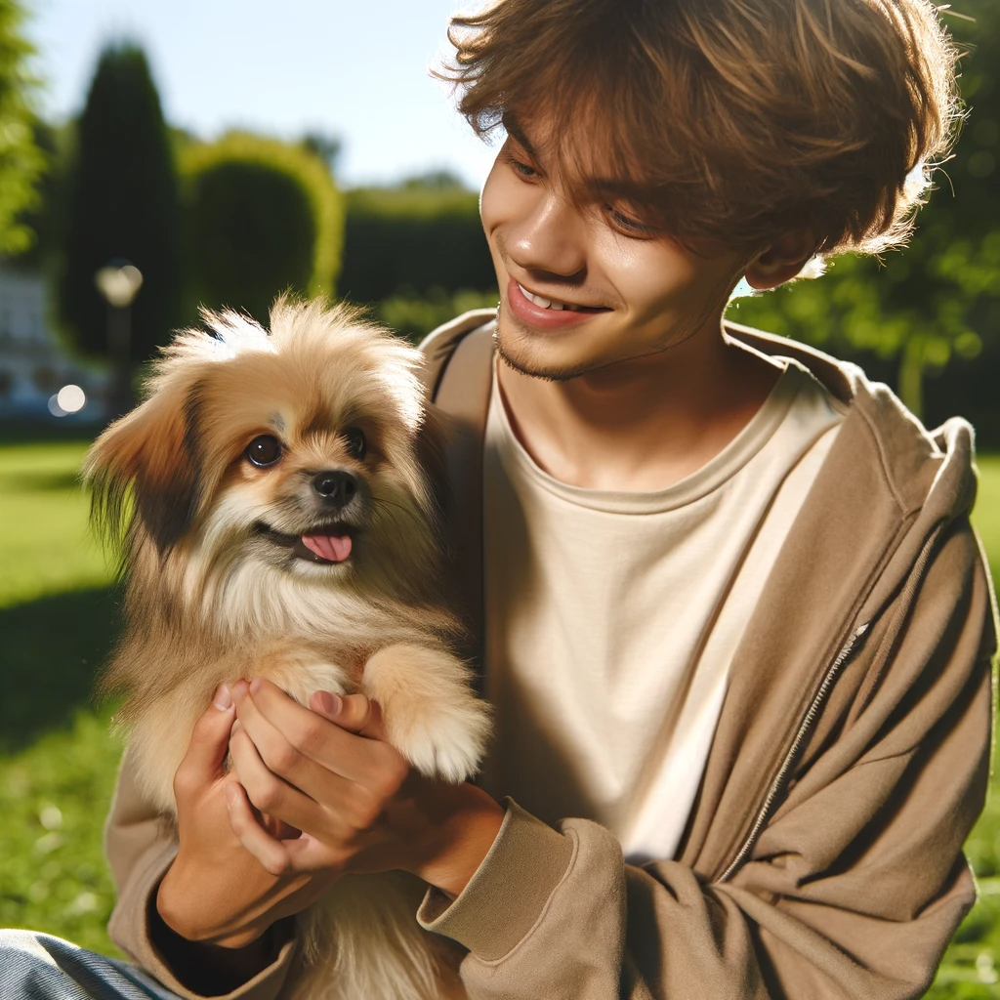

/Users/markhneedham/Downloads/ee60f430e8cb6ae769306860a9c03b2672e0eaf2.png


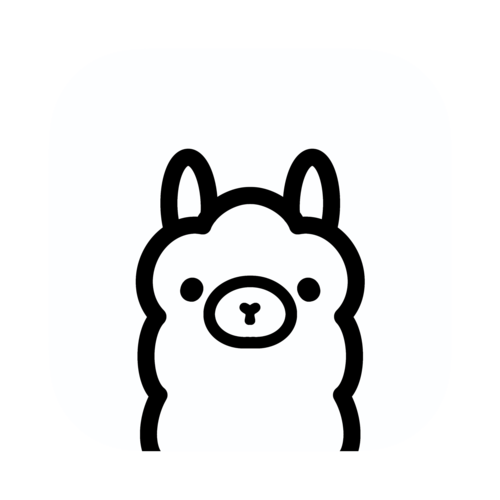

/Users/markhneedham/Downloads/image (4).png


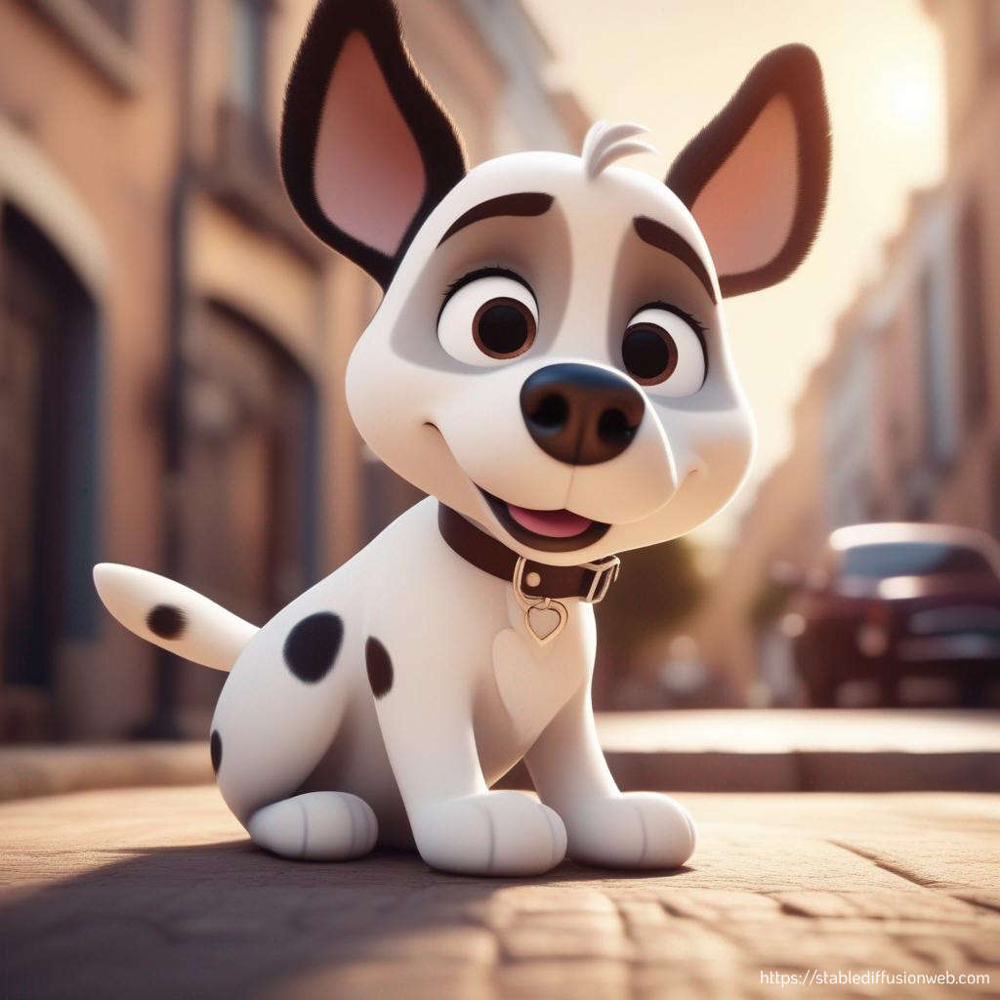

In [22]:
rows = table.search("dog").limit(3).to_pydantic(ImageFile)

for row in rows:
  print(row.image_uri)
  display(row.image)

## Searching by image

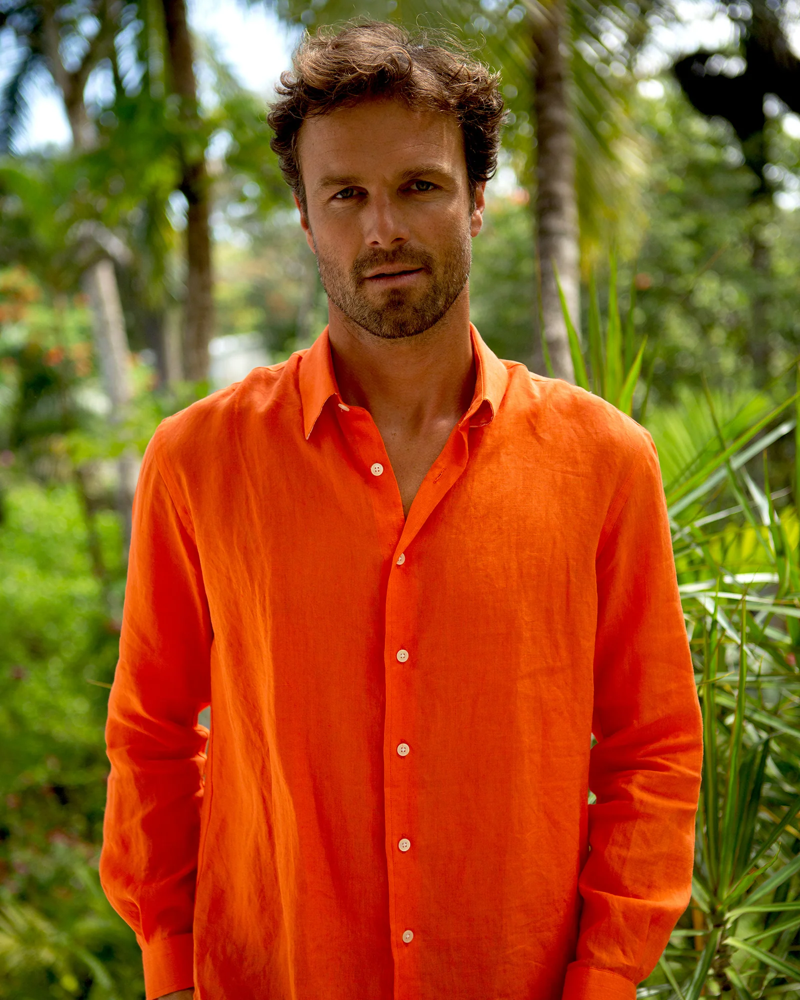

In [24]:
p = Path("search/orange-shirt-person.png").expanduser()
query_image = Image.open(p)
query_image

/Users/markhneedham/Downloads/me-eval_7.8.8.png


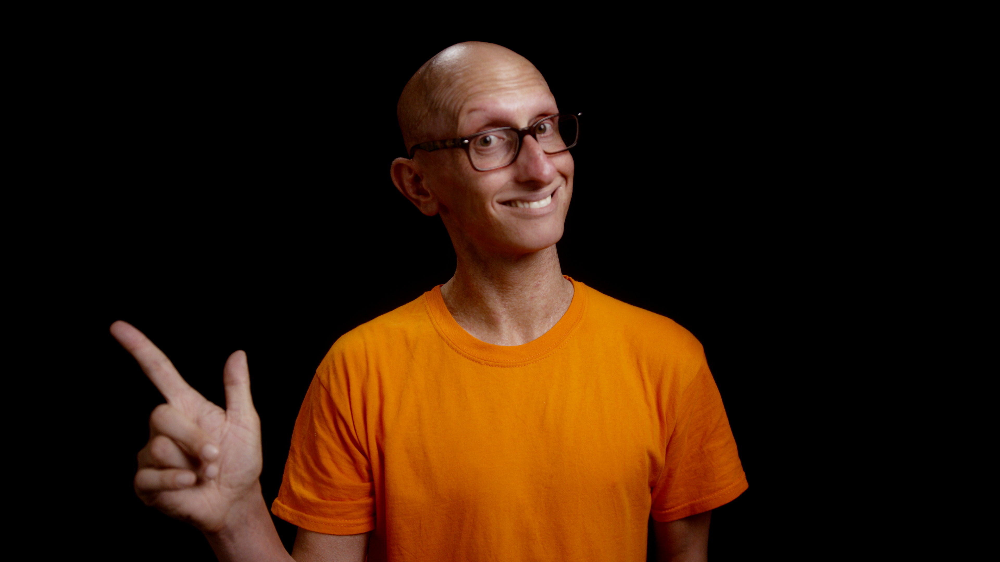

/Users/markhneedham/Downloads/me-eval_7.8.12.png


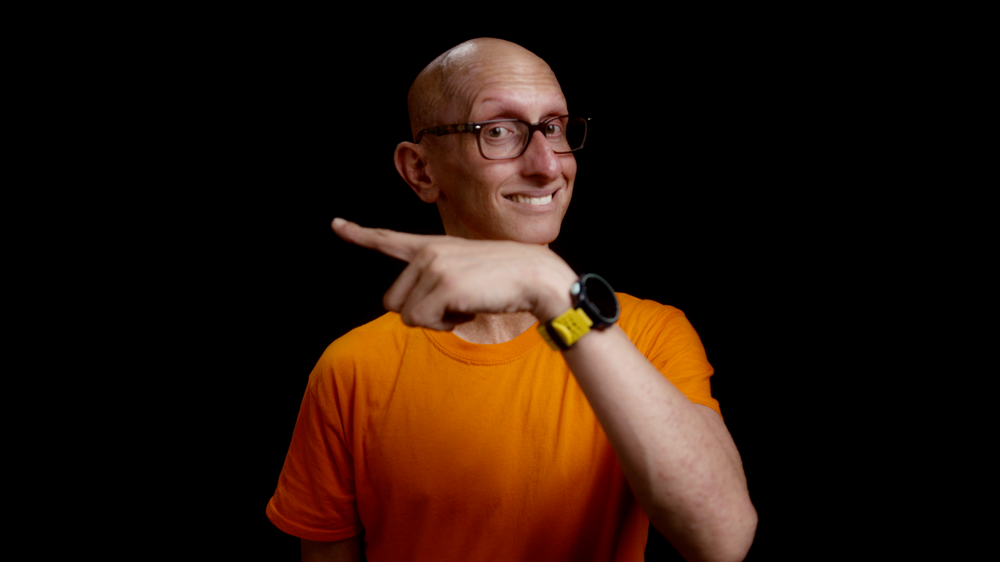

/Users/markhneedham/Downloads/me-eval_7.8.7.png


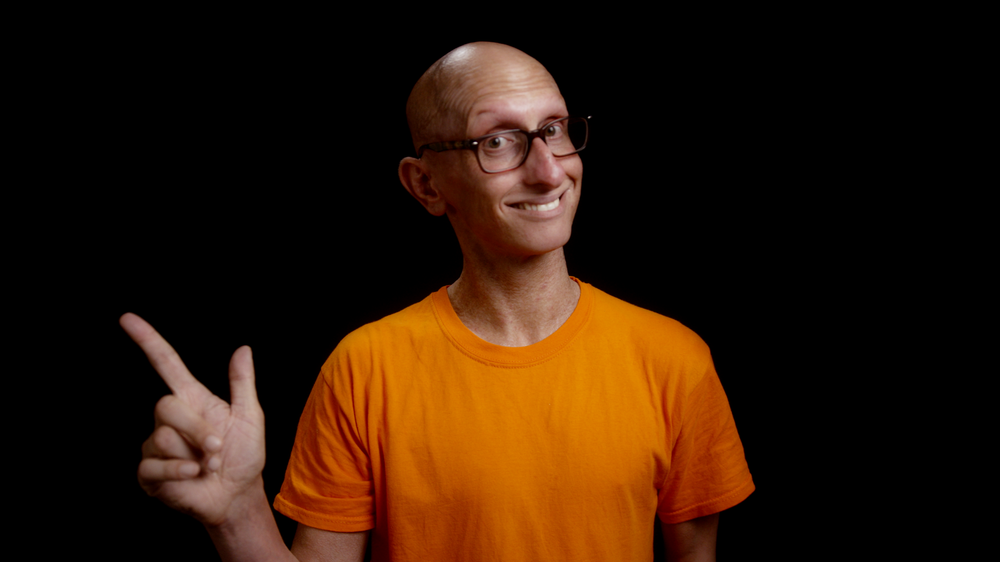

In [26]:
rows = table.search(query_image).limit(3).to_pydantic(ImageFile)

for row in rows:
  print(row.image_uri)
  display(row.image)